# Evaluation Project - 8: Rainfall Prediction - Weather Forecasting

**Problem Statement:**

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
1. Problem Statement: 
a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


**Dataset Description:**

Number of columns: 23


Date  - The date of observation

Location  -The common name of the location of the weather station

MinTemp  -The minimum temperature in degrees celsius

MaxTemp -The maximum temperature in degrees celsius

Rainfall  -The amount of rainfall recorded for the day in mm

Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

Sunshine  -The number of hours of bright sunshine in the day.

WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight

WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

WindDir9am -Direction of the wind at 9am

WindDir3pm -Direction of the wind at 3pm

WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am

WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

Humidity9am -Humidity (percent) at 9am

Humidity3pm -Humidity (percent) at 3pm

Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am

Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

Cloud9am - Fraction of sky obscured by cloud at 9am. 

Cloud3pm -Fraction of sky obscured by cloud 

Temp9am-Temperature (degrees C) at 9am

Temp3pm -Temperature (degrees C) at 3pm

RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0

RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".


**Dataset available below**

https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv
https://github.com/dsrscientist/dataset3

# Importing required libraries:

In [87]:
import pandas as pd 
import numpy as np 

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
# Getting over warning messages
import warnings
warnings.filterwarnings('ignore')
# Getting over warning messages
import warnings
warnings.filterwarnings('ignore')

In [88]:
from scipy.stats import zscore
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import metrics

# Importing required dataset:¶

In [89]:
df = pd.read_csv("https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv")
pd.set_option('display.max_columns', None) # This will enable us to see truncated columns
pd.set_option('display.max_rows', None) # This will enable us to see truncated rows
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
5,2008-12-06,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,19.0,24.0,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,No
6,2008-12-07,Albury,14.3,25.0,0.0,NaN,NaN,W,50.0,SW,W,20.0,24.0,49.0,19.0,1009.6,1008.2,1.0,NaN,18.1,24.6,No,No
7,2008-12-08,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,W,6.0,17.0,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,No
8,2008-12-09,Albury,9.7,31.9,0.0,NaN,NaN,NNW,80.0,SE,NW,7.0,28.0,42.0,9.0,1008.9,1003.6,NaN,NaN,18.3,30.2,No,Yes
9,2008-12-10,Albury,13.1,30.1,1.4,NaN,NaN,W,28.0,S,SSE,15.0,11.0,58.0,27.0,1007.0,1005.7,NaN,NaN,20.1,28.2,Yes,No


# Data profiling:

In [5]:
print('No of Rows:',df.shape[0])
print('No of Columns:',df.shape[1])

No of Rows: 8425
No of Columns: 23


In [6]:
df.size
print(f'Total number of elements in dataframe are {df.size}')

Total number of elements in dataframe are 193775


In [7]:
#Short summary of the dataframe

In [8]:
df.info(verbose = False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Columns: 23 entries, Date to RainTomorrow
dtypes: float64(16), object(7)
memory usage: 1.5+ MB


In [9]:
#full summary of the dataframe

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

In [11]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,8350.0,13.193305,5.403596,-2.0,9.20,13.3,17.4,28.5
MaxTemp,8365.0,23.859976,6.136408,8.2,19.30,23.3,28.0,45.5
Rainfall,8185.0,2.805913,10.459379,0.0,0.00,0.0,1.0,371.0
Evaporation,4913.0,5.389395,5.044484,0.0,2.60,4.6,7.0,145.0
Sunshine,4431.0,7.632205,3.896235,0.0,4.75,8.7,10.7,13.9
WindGustSpeed,7434.0,40.174469,14.665721,7.0,30.00,39.0,50.0,107.0
WindSpeed9am,8349.0,13.847646,10.174579,0.0,6.00,13.0,20.0,63.0
WindSpeed3pm,8318.0,18.533662,9.766986,0.0,11.00,19.0,24.0,83.0
Humidity9am,8366.0,67.822496,16.833283,10.0,56.00,68.0,80.0,100.0
Humidity3pm,8323.0,51.249790,18.423774,6.0,39.00,51.0,63.0,99.0


In [90]:
numerical_data = [feature for feature in df.columns if df[feature].dtype != 'O']
print('Total Numerical Features are = ',len(numerical_data))

Total Numerical Features are =  16


In [91]:
categorical_data = [feature for feature in df.columns if df[feature].dtype == 'O']
print('Total Categorical Features are = ',len(categorical_data))

Total Categorical Features are =  7


## Checking  Series containing counts of unique rows in the DataFrame

In [92]:
df.nunique().to_frame("Unique Values")

,Unique Values
Date,3004
Location,12
MinTemp,285
MaxTemp,331
Rainfall,250
Evaporation,116
Sunshine,140
WindGustDir,16
WindGustSpeed,52
WindDir9am,16


## Checking Mising value featurewise

In [93]:
df.isna().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

In [94]:
print(f'Total Number of Missing value in our dataframe are {df.isna().sum().sum()}')

Total Number of Missing value in our dataframe are 19472


In [95]:
#Filling null values in MinTemp with it's mean
df['MinTemp'] = df['MinTemp'].fillna(df['MinTemp'].mean())

#Filling null values in MaxTemp with it's mean
df['MaxTemp'] = df['MaxTemp'].fillna(df['MaxTemp'].mean())

#Filling null values in Rainfall with it's mode, as most of the rows have 0 rainfall.
df['Rainfall'] = df['Rainfall'].fillna(df['Rainfall'].mode()[0])

#Filling null values in Evaporation with it's mean
df['Evaporation'] = df['Evaporation'].fillna(df['Evaporation'].mean())

#Filling null values in Sunshine with it's mean
df['Sunshine'] = df['Sunshine'].fillna(df['Sunshine'].mean())

#Filling null values in WindGustDir with it's mode
df['WindGustDir'] = df['WindGustDir'].fillna(df['WindGustDir'].mode()[0])

#Filling null values in WindGustSpeed with it's mean
df['WindGustSpeed'] = df['WindGustSpeed'].fillna(df['WindGustSpeed'].mean())

#Filling null values in WindDir9am with it's mode
df['WindDir9am'] = df['WindDir9am'].fillna(df['WindDir9am'].mode()[0])

#Filling null values in WindDir3pm with it's mode
df['WindDir3pm'] = df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0])

#Filling null values in WindSpeed9am with it's mean
df['WindSpeed9am'] = df['WindSpeed9am'].fillna(df['WindSpeed9am'].mean())

#Filling null values in WindSpeed3pm with it's mean
df['WindSpeed3pm'] = df['WindSpeed3pm'].fillna(df['WindSpeed3pm'].mean())

#Filling null values in Humidity9am with it's mean
df['Humidity9am'] = df['Humidity9am'].fillna(df['Humidity9am'].mean())

#Filling null values in Humidity3pm with it's mean
df['Humidity3pm'] = df['Humidity3pm'].fillna(df['Humidity3pm'].mean())

#Filling null values in Pressure9am with it's mean
df['Pressure9am'] = df['Pressure9am'].fillna(df['Pressure9am'].mean())

#Filling null values in Pressure3pm with it's mean
df['Pressure3pm'] = df['Pressure3pm'].fillna(df['Pressure3pm'].mean())

#Filling null values in Cloud9am with it's mean
df['Cloud9am'] = df['Cloud9am'].fillna(df['Cloud9am'].mean())

#Filling null values in Cloud3pm with it's mean
df['Cloud3pm'] = df['Cloud3pm'].fillna(df['Cloud3pm'].mean())

#Filling null values in Temp9am with it's mean
df['Temp9am'] = df['Temp9am'].fillna(df['Temp9am'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in RainToday with it's mode
df['RainToday'] = df['RainToday'].fillna(df['RainToday'].mode()[0])

#Filling null values in RainTomorrow with it's mode
df['RainTomorrow'] = df['RainTomorrow'].fillna(df['RainTomorrow'].mode()[0])

In [96]:
df.isna().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

- **Now our Dataframe became Null free**

# Exploratory Data Analysis:

<Figure size 288000x72000 with 0 Axes>

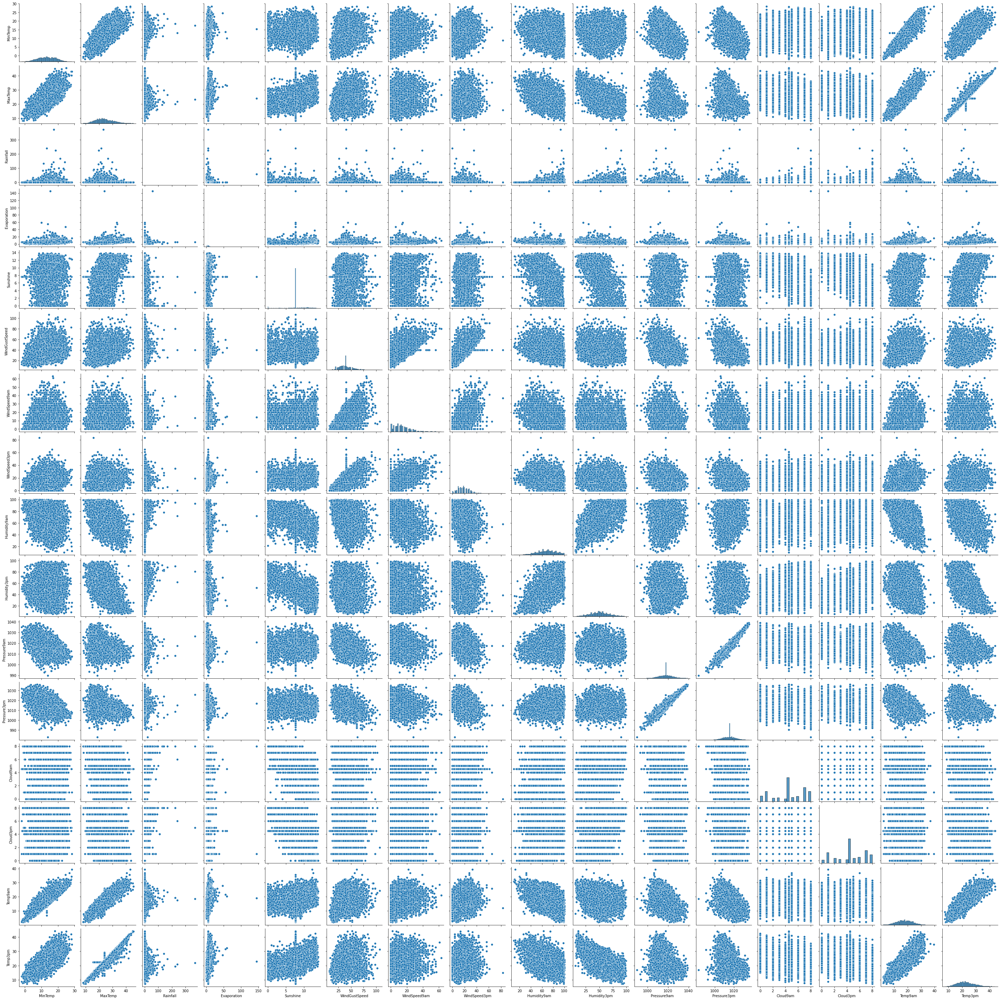

In [97]:
plt.figure(figsize=(4000,1000))
sns.pairplot(df)

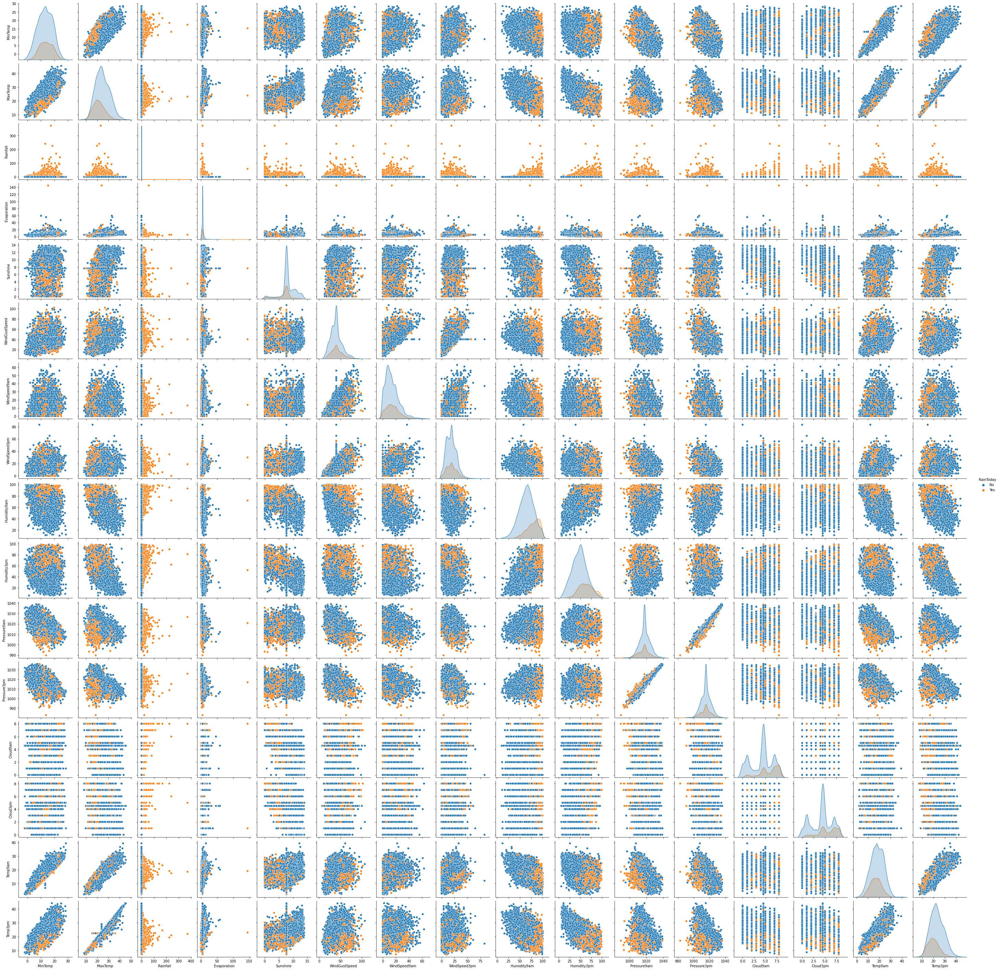

In [98]:
sns.pairplot(df, hue ='RainToday')

## Observation:
- From above plot we can see that there is positive relation with independent feature and negative relationship with independent featureand some of the feature have no relation to each other.


In [21]:
categorical_data

['Date',
 'Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [22]:
for col in categorical_data:
    print(col)
    print(df[col].value_counts())
    print("⚏"*80)

Date
2011-01-31    5
2011-05-08    5
2011-05-21    5
2011-05-20    5
2011-05-19    5
2011-05-18    5
2011-05-17    5
2011-05-16    5
2011-05-15    5
2011-05-14    5
2011-05-13    5
2011-05-12    5
2011-05-11    5
2011-05-10    5
2011-05-09    5
2011-05-07    5
2011-05-23    5
2011-05-06    5
2011-05-05    5
2011-05-04    5
2011-05-03    5
2011-05-02    5
2011-05-01    5
2011-03-31    5
2011-03-30    5
2011-03-29    5
2011-03-28    5
2011-03-27    5
2011-03-26    5
2011-03-25    5
2011-05-22    5
2011-05-24    5
2011-03-23    5
2011-06-10    5
2011-06-23    5
2011-06-22    5
2011-06-21    5
2011-06-20    5
2011-06-19    5
2011-06-18    5
2011-06-17    5
2011-06-16    5
2011-06-15    5
2011-06-14    5
2011-06-13    5
2011-06-12    5
2011-06-11    5
2011-06-09    5
2011-05-25    5
2011-06-08    5
2011-06-06    5
2011-06-05    5
2011-06-04    5
2011-06-03    5
2011-06-02    5
2011-06-01    5
2011-05-31    5
2011-05-30    5
2011-05-29    5
2011-05-28    5
2011-05-27    5
2011-05-26    5
201

# Observation:
- From above we can see that data is imbalanced for our target feature i.e RainTomorrow
- So we nedd to use SMOT method to balance the data

 ## Data Exploration For Categerical Data

## Target Feature

In [23]:
target_df=df['RainTomorrow'].value_counts(normalize=True,dropna=False)*100

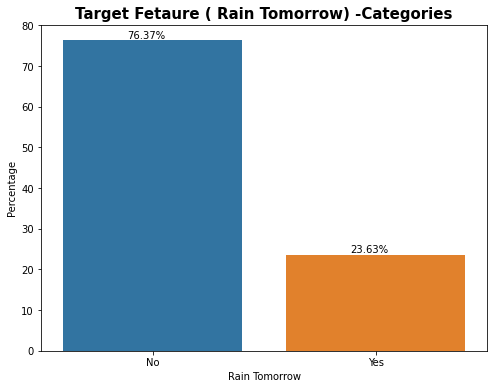

In [24]:
plt.figure(figsize=(8,6))
plt.title("Target Fetaure ( Rain Tomorrow) -Categories",fontweight='bold',fontsize=15)
ax=sns.barplot(x=target_df.index,y=target_df.values)
plt.xlabel('Rain Tomorrow')
plt.ylabel('Percentage')



for p in ax.patches:
    height=p.get_height()
    width=p.get_width()
    x,_=p.get_xy()
    ax.text(x +width/2.8,height+.5,f'{height:.2f}%')

# Depependent Feature

## Date

In [25]:
df['Date'].nunique()

3004

## Location

In [26]:
df['Location'].unique()

array(['Albury', 'CoffsHarbour', 'Newcastle', 'Penrith', 'Williamtown',
       'Wollongong', 'Melbourne', 'Brisbane', 'Adelaide', 'PerthAirport',
       'Darwin', 'Uluru'], dtype=object)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 [Text(0, 0, 'Melbourne'),
  Text(1, 0, 'Williamtown'),
  Text(2, 0, 'PerthAirport'),
  Text(3, 0, 'Albury'),
  Text(4, 0, 'Newcastle'),
  Text(5, 0, 'CoffsHarbour'),
  Text(6, 0, 'Brisbane'),
  Text(7, 0, 'Penrith'),
  Text(8, 0, 'Wollongong'),
  Text(9, 0, 'Darwin'),
  Text(10, 0, 'Adelaide'),
  Text(11, 0, 'Uluru')])

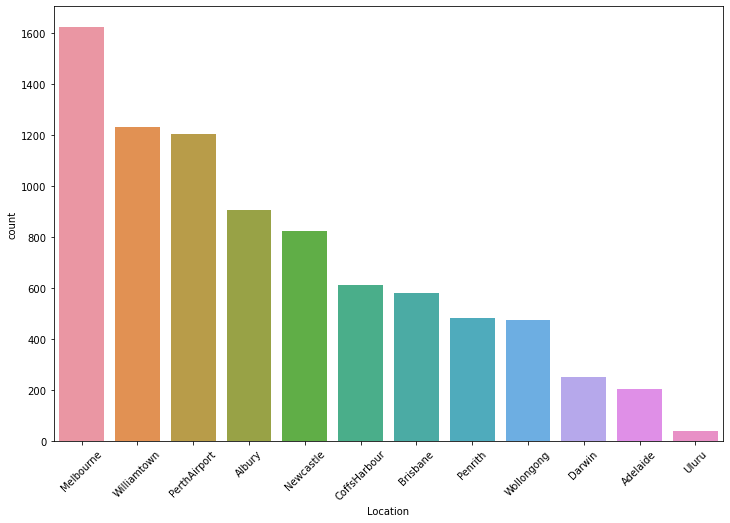

In [27]:
plt.figure(figsize=(12,8))
sns.countplot(df['Location'],order=df['Location'].value_counts().index)
plt.xticks(rotation=45)

## Observation
- We have the highest rainfall data from Melbourbne followed by williamtown and least from Uluru.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'N'),
  Text(1, 0, 'SSE'),
  Text(2, 0, 'S'),
  Text(3, 0, 'SW'),
  Text(4, 0, 'E'),
  Text(5, 0, 'WNW'),
  Text(6, 0, 'W'),
  Text(7, 0, 'WSW'),
  Text(8, 0, 'SE'),
  Text(9, 0, 'ENE'),
  Text(10, 0, 'SSW'),
  Text(11, 0, 'NW'),
  Text(12, 0, 'NE'),
  Text(13, 0, 'NNE'),
  Text(14, 0, 'ESE'),
  Text(15, 0, 'NNW')])

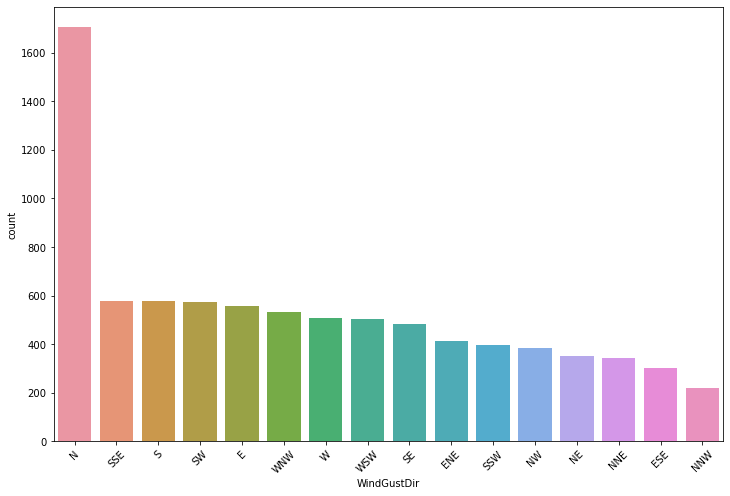

In [28]:
plt.figure(figsize=(12,8))
sns.countplot(df['WindGustDir'],order=df['WindGustDir'].value_counts().index)
plt.xticks(rotation=45)

## Observation
- We can clearly see that the wind gust was strongest towards the north, followed by the SSE,S,SW and least is towards NNW.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'N'),
  Text(1, 0, 'SSE'),
  Text(2, 0, 'S'),
  Text(3, 0, 'SW'),
  Text(4, 0, 'E'),
  Text(5, 0, 'WNW'),
  Text(6, 0, 'W'),
  Text(7, 0, 'WSW'),
  Text(8, 0, 'SE'),
  Text(9, 0, 'ENE'),
  Text(10, 0, 'SSW'),
  Text(11, 0, 'NW'),
  Text(12, 0, 'NE'),
  Text(13, 0, 'NNE'),
  Text(14, 0, 'ESE'),
  Text(15, 0, 'NNW')])

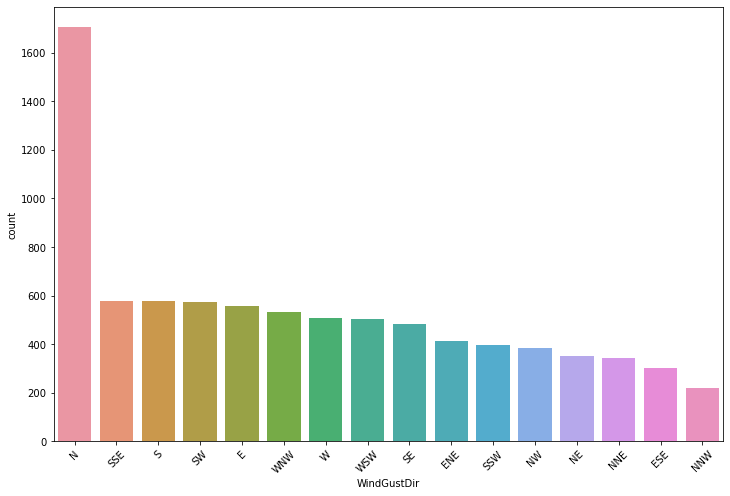

In [86]:
plt.figure(figsize=(12,8))
sns.countplot(df['WindGustDir'],order=df['WindGustDir'].value_counts().index)
plt.xticks(rotation=45)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'N'),
  Text(1, 0, 'SW'),
  Text(2, 0, 'NW'),
  Text(3, 0, 'WSW'),
  Text(4, 0, 'SE'),
  Text(5, 0, 'WNW'),
  Text(6, 0, 'SSW'),
  Text(7, 0, 'ENE'),
  Text(8, 0, 'NNE'),
  Text(9, 0, 'W'),
  Text(10, 0, 'NE'),
  Text(11, 0, 'S'),
  Text(12, 0, 'E'),
  Text(13, 0, 'SSE'),
  Text(14, 0, 'NNW'),
  Text(15, 0, 'ESE')])

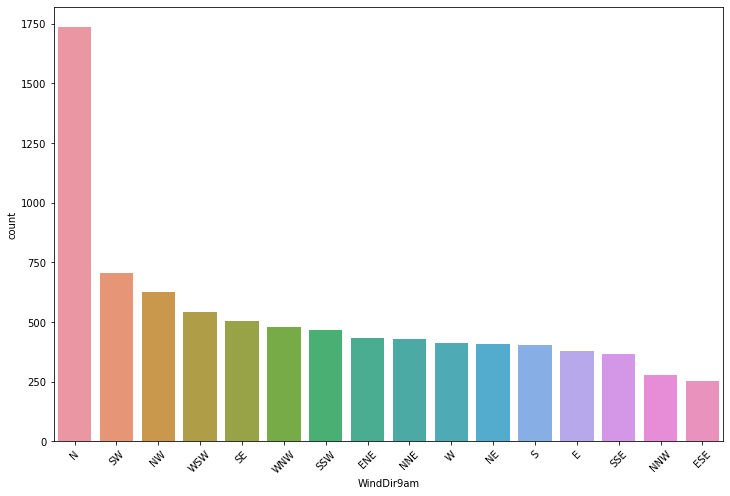

In [39]:
plt.figure(figsize=(12,8))
sns.countplot(df['WindDir9am'],order=df['WindDir9am'].value_counts().index)
plt.xticks(rotation=45)

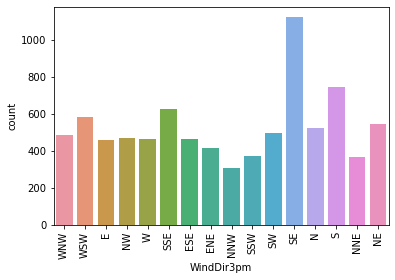

In [40]:
sns.countplot(df['WindDir3pm'])
plt.xticks(rotation=90)
plt.show()

## Observation
- In the plots we can clearly see that the wing direction was towards the N at 9am and in the SE at 3pm

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'SE'),
  Text(1, 0, 'S'),
  Text(2, 0, 'SSE'),
  Text(3, 0, 'WSW'),
  Text(4, 0, 'NE'),
  Text(5, 0, 'N'),
  Text(6, 0, 'SW'),
  Text(7, 0, 'WNW'),
  Text(8, 0, 'NW'),
  Text(9, 0, 'W'),
  Text(10, 0, 'ESE'),
  Text(11, 0, 'E'),
  Text(12, 0, 'ENE'),
  Text(13, 0, 'SSW'),
  Text(14, 0, 'NNE'),
  Text(15, 0, 'NNW')])

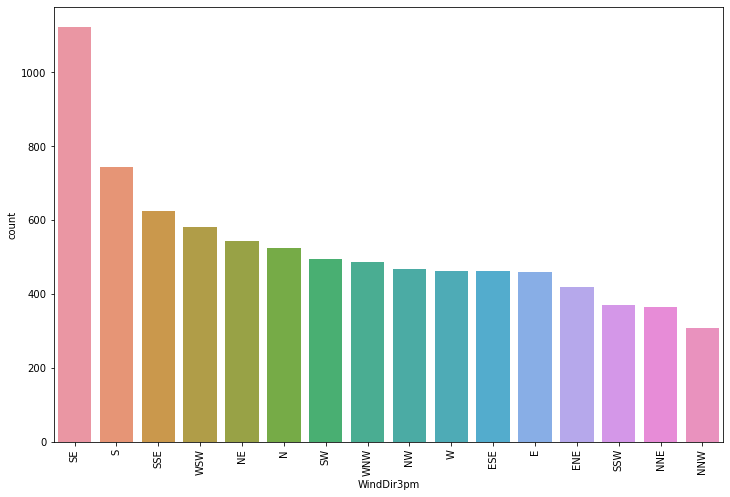

In [41]:
plt.figure(figsize=(12,8))
sns.countplot(df['WindDir3pm'],order=df['WindDir3pm'].value_counts().index)
plt.xticks(rotation=90)

# Observation:
- In the plots we can clearly see that the wing direction was towards the SE at 3pm

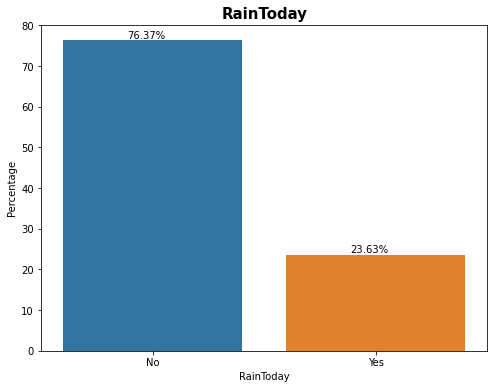

In [42]:
RainToday_df=df['RainToday'].value_counts(normalize=True,dropna=False)*100
plt.figure(figsize=(8,6))
plt.title("RainToday",fontweight='bold',fontsize=15)
ax=sns.barplot(x=target_df.index,y=target_df.values)
plt.xlabel('RainToday')
plt.ylabel('Percentage')



for p in ax.patches:
    height=p.get_height()
    width=p.get_width()
    x,_=p.get_xy()
    ax.text(x +width/2.8,height+.5,f'{height:.2f}%')

 ## Data Exploration For Numerical Data

In [43]:
numerical_data

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

<AxesSubplot:xlabel='MinTemp', ylabel='Density'>

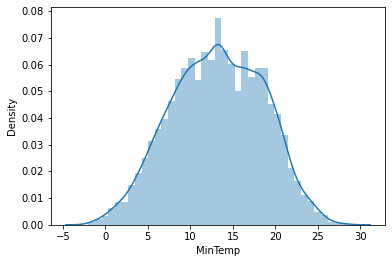

In [44]:
sns.distplot(df['MinTemp'])

## Observation:
- Min Temp is normally distributed.

<AxesSubplot:xlabel='MaxTemp', ylabel='Density'>

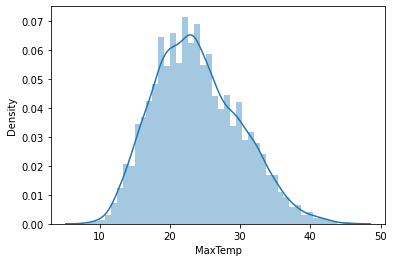

In [45]:
sns.distplot(df['MaxTemp'])

## Observation:
- Max Temp is slightly skewed.

<AxesSubplot:xlabel='Rainfall', ylabel='Density'>

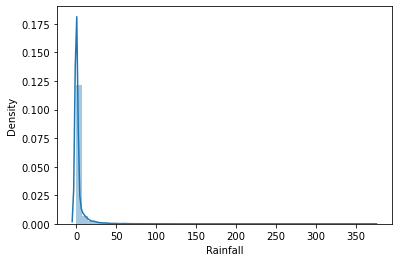

In [46]:
sns.distplot(df['Rainfall'])

## Observation:
- Rainfall more skewed.

<AxesSubplot:xlabel='Evaporation', ylabel='Density'>

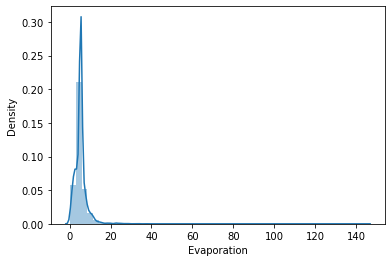

In [47]:
sns.distplot(df['Evaporation'])

## Observation:
- Evaporation is more skewed

<AxesSubplot:xlabel='Sunshine', ylabel='Density'>

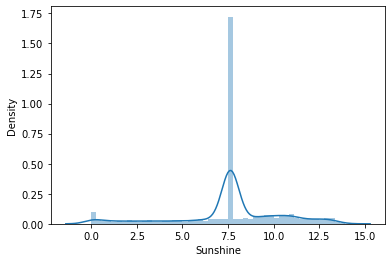

In [48]:
sns.distplot(df['Sunshine'])

## Observation:
- Sunshine is not normally distributed.

<AxesSubplot:xlabel='WindGustSpeed', ylabel='Density'>

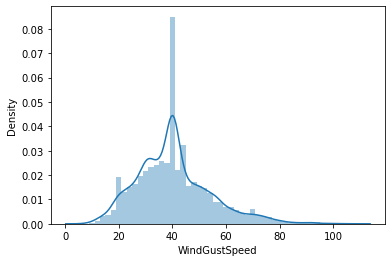

In [49]:
sns.distplot(df['WindGustSpeed'])

<AxesSubplot:xlabel='WindSpeed3pm', ylabel='Density'>

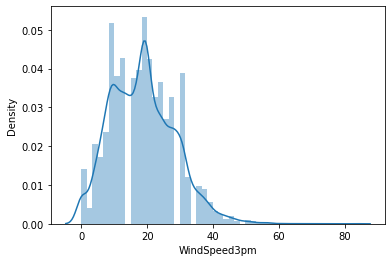

In [50]:
sns.distplot(df['WindSpeed3pm'])

<AxesSubplot:xlabel='WindSpeed9am', ylabel='Density'>

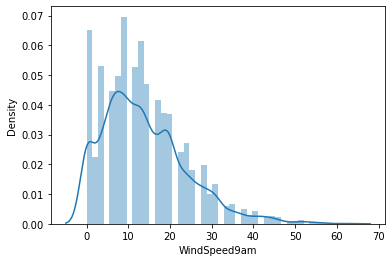

In [51]:
sns.distplot(df['WindSpeed9am'])

## Observation:
- WindGustSpeed, WindSpeed9am,WindSpeed3pm is more skewed.

<AxesSubplot:xlabel='Humidity9am', ylabel='Density'>

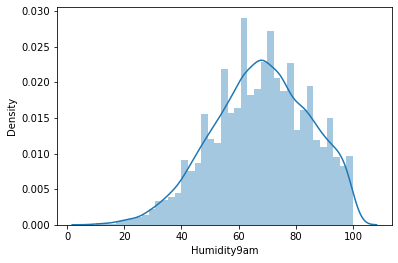

In [52]:
sns.distplot(df['Humidity9am'])

## Observation:
- Humidity9am is slightly skewed and Humidity3pm is normally distributed.

<AxesSubplot:xlabel='Pressure9am', ylabel='Density'>

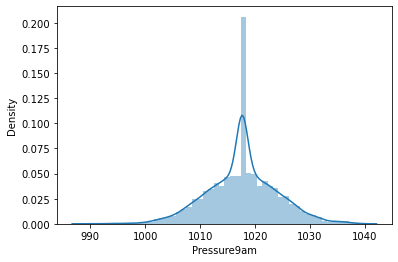

In [53]:
sns.distplot(df['Pressure9am'])

<AxesSubplot:xlabel='Pressure3pm', ylabel='Density'>

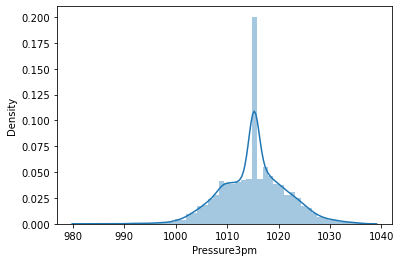

In [54]:
sns.distplot(df['Pressure3pm'])

<AxesSubplot:xlabel='Cloud9am', ylabel='Density'>

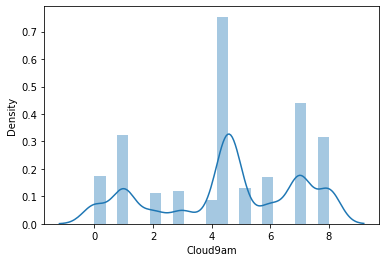

In [55]:
sns.distplot(df['Cloud9am'])

<AxesSubplot:xlabel='Cloud3pm', ylabel='Density'>

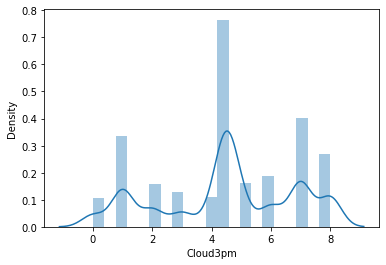

In [56]:
sns.distplot(df['Cloud3pm'])

<AxesSubplot:xlabel='Temp9am', ylabel='Density'>

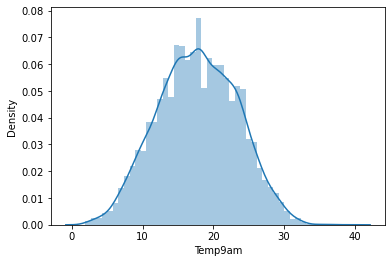

In [57]:
sns.distplot(df['Temp9am'])

<AxesSubplot:xlabel='Temp3pm', ylabel='Density'>

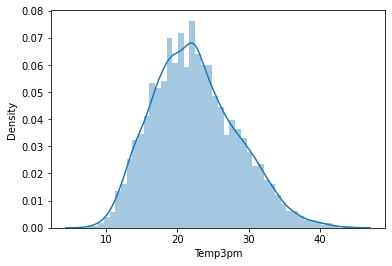

In [58]:
sns.distplot(df['Temp3pm'])

## Observation:
- Pressure9am, Pressure3pm, Cloud9am, Cloud3pm, Temp9am, Temp3pm, Day, Month and Year has no skewness however the data is not distributed uniformly.

In [59]:
# Checking The relation between target and independent feature.

Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64


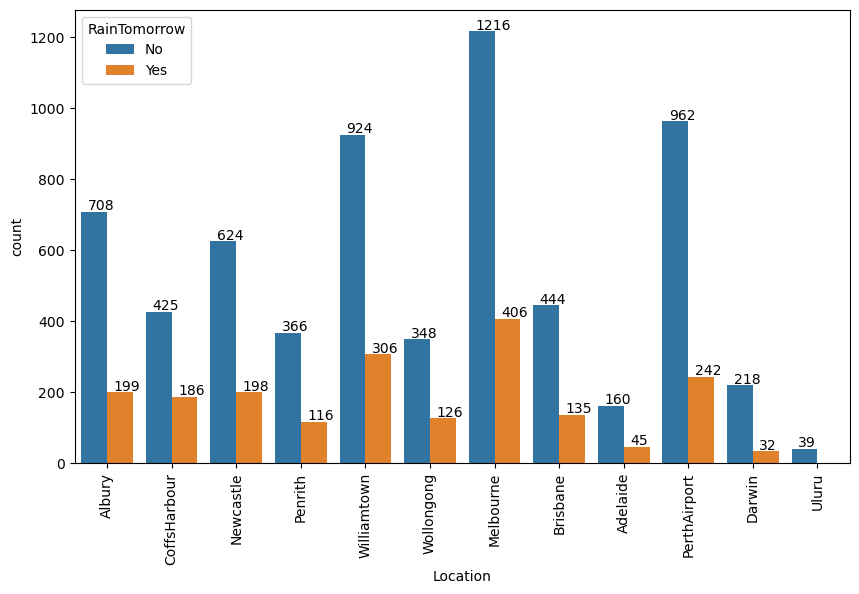

In [60]:
# Countplot for 
plt.figure(dpi=100,figsize=(10,6))
plot = sns.countplot('Location',data=df, hue='RainTomorrow')
plot.set_xticklabels(plot.get_xticklabels(),rotation = 90)
print(df.Location.value_counts())
for p in plot.patches:
    plot.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+5))

# Observation:
- From above plot we can say that in melbourne Chances of rainfall is too hight where as in ulluru there is not a single possibility of raining

<AxesSubplot:xlabel='MinTemp', ylabel='MaxTemp'>

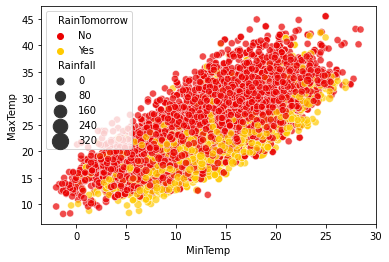

In [61]:
sns.scatterplot(df['MinTemp'],df['MaxTemp'],hue='RainTomorrow',data=df,palette = "hot",
                size = "Rainfall",sizes = (50, 300), alpha = 0.7)

<AxesSubplot:xlabel='Sunshine', ylabel='Evaporation'>

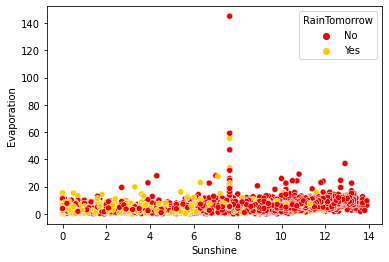

In [62]:
sns.scatterplot(df['Sunshine'],df['Evaporation'],hue='RainTomorrow',data=df,palette = "hot")

<AxesSubplot:xlabel='WindGustSpeed', ylabel='WindGustDir'>

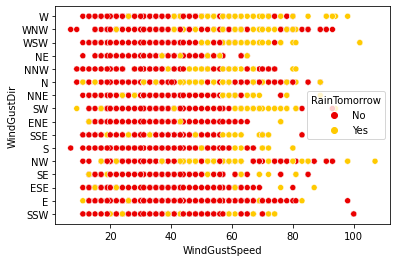

In [63]:
sns.scatterplot(df['WindGustSpeed'],df['WindGustDir'],hue='RainTomorrow',data=df,palette = "hot")

<AxesSubplot:xlabel='WindSpeed9am', ylabel='WindDir9am'>

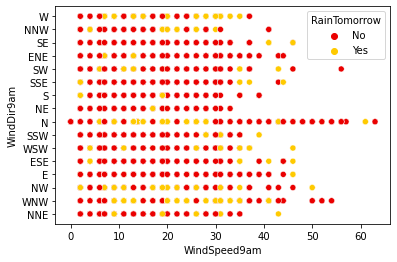

In [64]:
sns.scatterplot(df['WindSpeed9am'],df['WindDir9am'],hue='RainTomorrow',data=df,palette = "hot")

<AxesSubplot:xlabel='WindSpeed3pm', ylabel='WindDir3pm'>

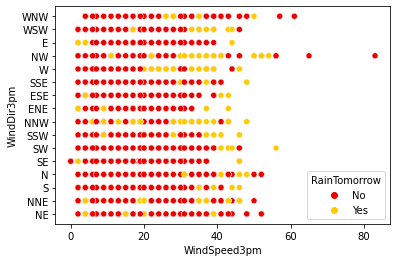

In [65]:
sns.scatterplot(df['WindSpeed3pm'],df['WindDir3pm'],hue='RainTomorrow',data=df,palette = "hot")

<AxesSubplot:xlabel='Humidity3pm', ylabel='Humidity9am'>

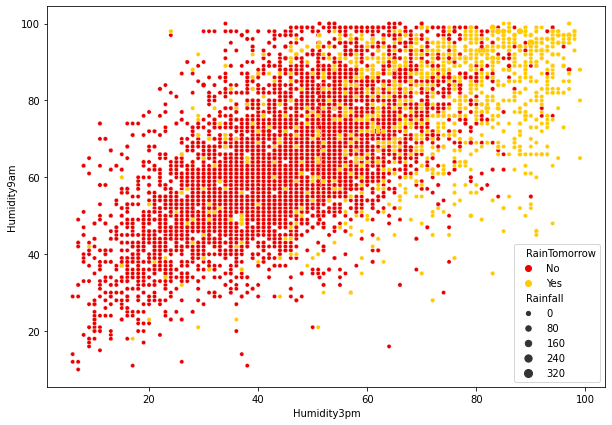

In [66]:
plt.figure(figsize=(10,7))
sns.scatterplot(df['Humidity3pm'],df['Humidity9am'],hue='RainTomorrow',size='Rainfall',data=df,palette = "hot")

<AxesSubplot:xlabel='Pressure3pm', ylabel='Pressure9am'>

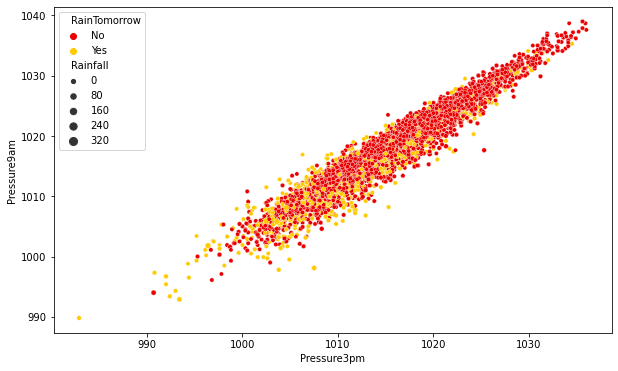

In [67]:
plt.figure(figsize=(10,6))
sns.scatterplot(df['Pressure3pm'],df['Pressure9am'],hue='RainTomorrow',size='Rainfall',data=df,palette = "hot")

<AxesSubplot:xlabel='Cloud3pm', ylabel='Cloud9am'>

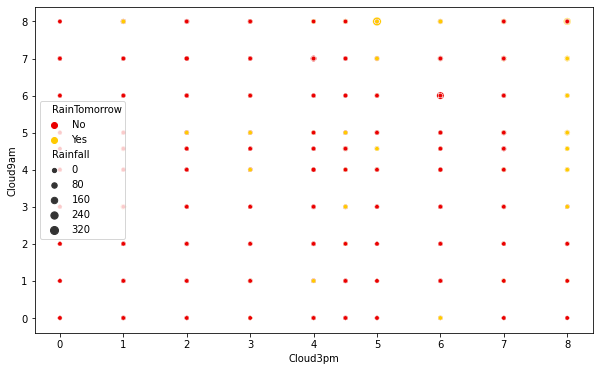

In [68]:
plt.figure(figsize=(10,6))
sns.scatterplot(df['Cloud3pm'],df['Cloud9am'],hue='RainTomorrow',size='Rainfall',data=df,palette = "hot")

<AxesSubplot:xlabel='Temp3pm', ylabel='Temp9am'>

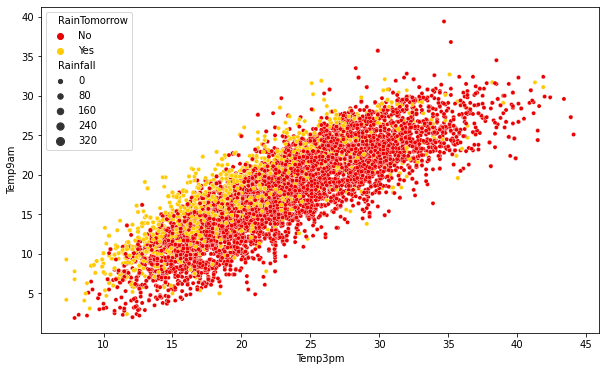

In [69]:
plt.figure(figsize=(10,6))
sns.scatterplot(df['Temp3pm'],df['Temp9am'],hue='RainTomorrow',size='Rainfall',data=df,palette = "hot")

<AxesSubplot:title={'center':'RainTomorrow'}, xlabel='RainTomorrow', ylabel='Location'>

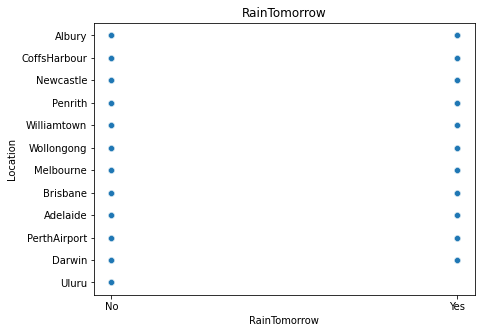

In [70]:
#checking the corelation between location with both the targets (Rainfall and Rain Tommorow)
plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('RainTomorrow')
sns.scatterplot(x='RainTomorrow',y='Location',data=df,palette = "hot")


# Observation:
- We can see that location does not have any major impact on the prediction of rainfall

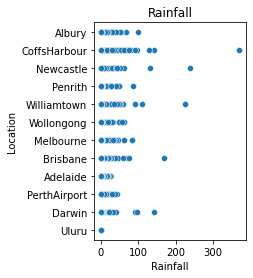

In [71]:
plt.subplot(1,2,2)
plt.title('Rainfall')
sns.scatterplot(x='Rainfall',y='Location',data=df)
plt.show()

We can see that location does not have any major impact on the prediction of rainfall, however we will not drop the feature as prediction is done as per region.

<AxesSubplot:title={'center':'RainTomorrow'}, xlabel='RainTomorrow', ylabel='WindGustDir'>

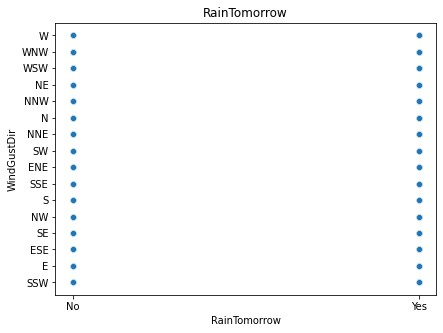

In [73]:
#checking the corelation between WindGustDir with both the targets (Rainfall and Rain Tommorow)
plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('RainTomorrow')
sns.scatterplot(x='RainTomorrow',y='WindGustDir',data=df)


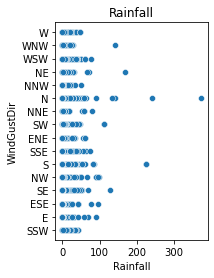

In [74]:
plt.subplot(1,2,2)
plt.title('Rainfall')
sns.scatterplot(x='Rainfall',y='WindGustDir',data=df)
plt.show()

# Observation:
- From this graph we can observe that there is no linear relation of the feature with both the targets

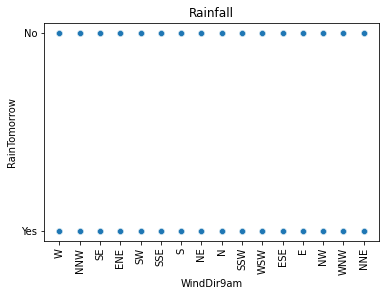

In [75]:
plt.subplot(1,1,1)
plt.title('Rainfall')
sns.scatterplot(x='WindDir9am',y='RainTomorrow',data=df,palette="Yellow")
plt.xticks(rotation=90)
plt.show()

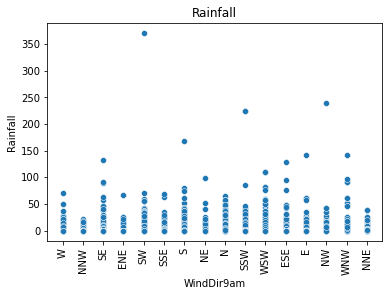

In [76]:
plt.subplot(1,1,1)
plt.title('Rainfall')
sns.scatterplot(x='WindDir9am',y='Rainfall',data=df,palette="Yellow")
plt.xticks(rotation=90)
plt.show()

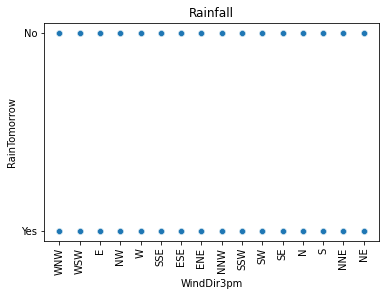

In [77]:
plt.subplot(1,1,1)
plt.title('Rainfall')
sns.scatterplot(x='WindDir3pm',y='RainTomorrow',data=df,palette="Yellow")
plt.xticks(rotation=90)
plt.show()

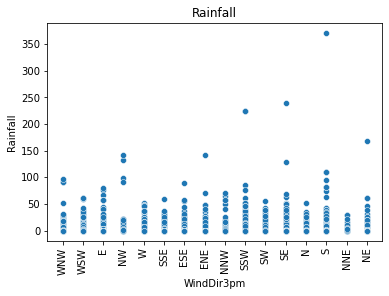

In [78]:
plt.subplot(1,1,1)
plt.title('Rainfall')
sns.scatterplot(x='WindDir3pm',y='Rainfall',data=df,palette="Yellow")
plt.xticks(rotation=90)
plt.show()

# Observation:
- We donot see any linear relation either

- Checking the relation between Rainfall today and Rainfall Tomorrow

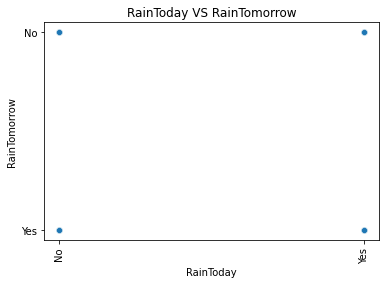

In [79]:
plt.subplot(1,1,1)
plt.title('RainToday VS RainTomorrow')
sns.scatterplot(x='RainToday',y='RainTomorrow',data=df,palette="green")
plt.xticks(rotation=90)
plt.show()

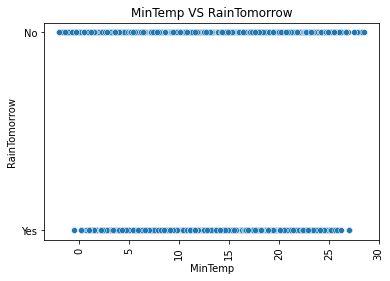

In [80]:
plt.subplot(1,1,1)
plt.title('MinTemp VS RainTomorrow')
sns.scatterplot(x='MinTemp',y='RainTomorrow',data=df,palette="green")
plt.xticks(rotation=90)
plt.show()

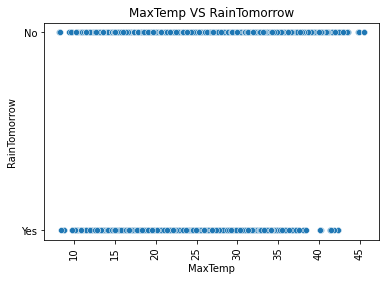

In [81]:
plt.subplot(1,1,1)
plt.title('MaxTemp VS RainTomorrow')
sns.scatterplot(x='MaxTemp',y='RainTomorrow',data=df,palette="green")
plt.xticks(rotation=90)
plt.show()

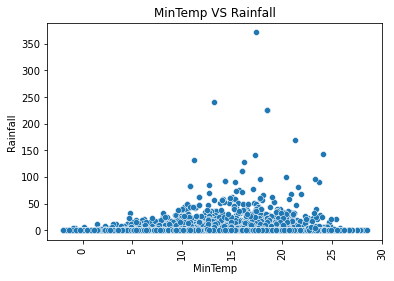

In [82]:
plt.subplot(1,1,1)
plt.title('MinTemp VS Rainfall')
sns.scatterplot(x='MinTemp',y='Rainfall',data=df,palette="green")
plt.xticks(rotation=90)
plt.show()

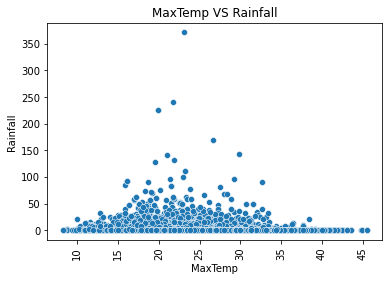

In [83]:
plt.subplot(1,1,1)
plt.title('MaxTemp VS Rainfall')
sns.scatterplot(x='MaxTemp',y='Rainfall',data=df,palette="green")
plt.xticks(rotation=90)
plt.show()

# Observation:
We can clearly see from the plotted graphs that there is no linear relation of max temp and min temp with both the targets

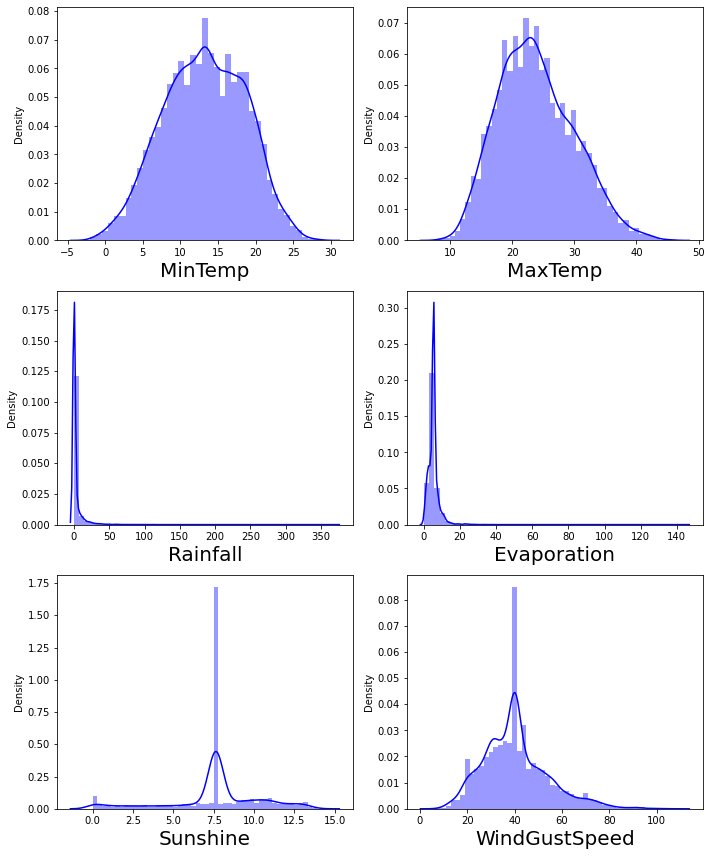

In [84]:
# Checking how the data has been distriubted in each numerical column
plt.figure(figsize=(10,12),facecolor='White')
plotnumber=1
for column in numerical_data:
    if plotnumber<=6:
        ax=plt.subplot(3,2,plotnumber)
        sns.distplot(df[column],color="Blue")
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.tight_layout()

# Checking the Outliers

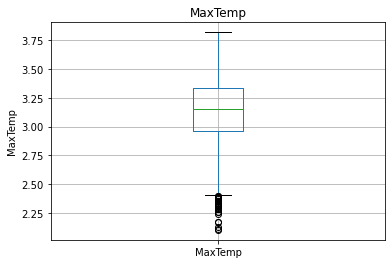

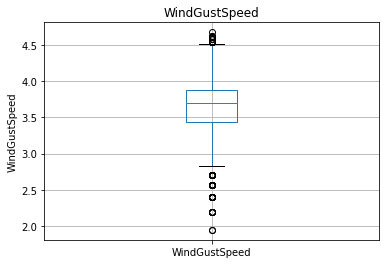

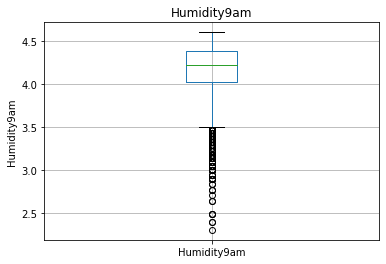

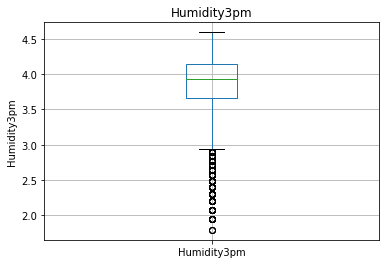

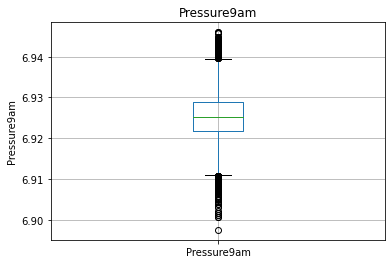

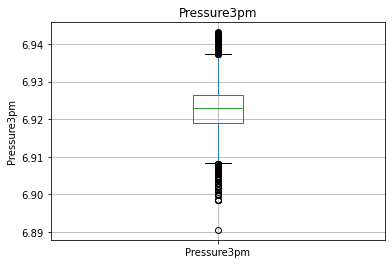

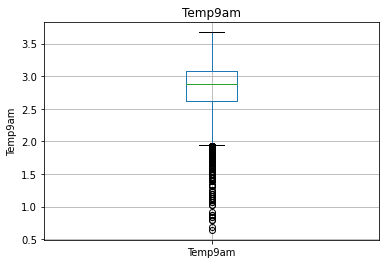

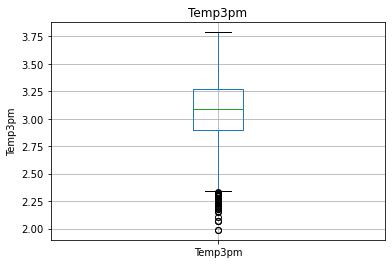

In [85]:
for feature in numerical_data:
    data=df.copy()
    if 0 in data[feature].unique():
        pass
    else:
        data[feature]=np.log(data[feature])
        data.boxplot(column=feature)
        plt.ylabel(feature)
        plt.title(feature)
        plt.show()

- From the above boxplots, we can see that features having outliers are: MaxTemp, Sunshine, WindGustSpeed, WindSpeed9am, Windspeed3pm, Humidity9am, Pressure9am, Pressure3pm, Temp9am, Temp3pm.

# Removing Outliers

In [86]:
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [87]:
numerical_data

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

In [88]:
Column_with_outlier = df[['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']]

In [89]:
z=np.abs(zscore(Column_with_outlier))

z

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,0.038425,1.570089e-01,0.206021,2.305893e-16,1.257472e-15,0.277710,0.607461,0.563297,0.189439,1.597406,1.584003,1.308665,1.413459,3.862851e-16,0.153712,0.108138
1,1.076989,2.028121e-01,0.264165,2.305893e-16,1.257472e-15,0.277710,0.972321,0.357200,1.420268,1.433568,1.121880,1.196072,0.000000,3.862851e-16,0.100217,0.312348
2,0.054526,3.009450e-01,0.264165,2.305893e-16,1.257472e-15,0.422897,0.508725,0.769394,1.777981,1.160505,1.599939,1.051309,0.000000,1.088680e+00,0.577390,0.127334
3,0.742365,6.771214e-01,0.264165,2.305893e-16,1.257472e-15,1.174166,0.281166,0.982428,1.360650,1.925081,0.006411,0.391836,0.000000,3.862851e-16,0.060269,0.682376
4,0.800625,1.380408e+00,0.167258,2.305893e-16,1.257472e-15,0.059928,0.676112,0.151104,0.845246,0.996668,1.090010,1.485596,1.001777,1.520830e+00,0.006773,1.220599
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,1.932140,7.523137e-02,0.264165,2.305893e-16,1.257472e-15,0.666009,0.083694,0.776331,1.002937,1.488181,1.109058,0.814518,0.000000,3.862851e-16,1.366273,0.007221
8421,1.783418,2.355231e-01,0.264165,2.305893e-16,1.257472e-15,1.319354,0.083694,0.982428,0.704843,1.652018,0.933770,0.621501,0.000000,3.862851e-16,1.223619,0.345987
8422,1.448794,4.972110e-01,0.264165,2.305893e-16,1.257472e-15,0.230447,0.478639,0.982428,0.883699,1.488181,0.535388,0.251553,0.000000,3.862851e-16,0.938310,0.615099
8423,1.002628,5.135665e-01,0.264165,2.305893e-16,1.257472e-15,0.883791,0.083694,1.188525,1.002937,1.488181,0.280424,0.203299,0.644950,1.088680e+00,0.474684,0.598279


In [90]:
# Creating new dataframe
new_df = df[(z<3).all(axis=1)] 
new_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.900000,0.6,5.389395,7.632205,W,44.000000,W,...,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.100000,0.0,5.389395,7.632205,WNW,44.000000,NNW,...,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.700000,0.0,5.389395,7.632205,WSW,46.000000,W,...,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.000000,0.0,5.389395,7.632205,NE,24.000000,SE,...,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.300000,1.0,5.389395,7.632205,W,41.000000,ENE,...,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.400000,0.0,5.389395,7.632205,E,31.000000,SE,...,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.300000,0.0,5.389395,7.632205,NNW,22.000000,SE,...,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.900000,0.0,5.389395,7.632205,N,37.000000,SE,...,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.000000,0.0,5.389395,7.632205,SE,28.000000,SSE,...,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,No,No


In [91]:
df.shape

(8425, 23)

In [92]:
new_df.shape

(7987, 23)

# Percentage data loss:

In [93]:
loss_percent=(8425-7987)/8425*100
print(loss_percent,'%')

5.198813056379822 %


# Observation:
After removing the outliers we are checking the data loss percentage by comparing the rows in our original data set and the new data set

5.1988% data loss is acceptable

# Checking the skewness of the dataset

In [94]:
new_df.skew().sort_values()

Sunshine        -0.723970
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Pressure9am      0.020735
Pressure3pm      0.044876
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
WindGustSpeed    0.506897
WindSpeed9am     0.711395
Evaporation      0.846181
Rainfall         3.519090
dtype: float64

# Removing skewness using log transformation

In [95]:
new_df["Rainfall"] = np.log1p(new_df["Rainfall"])
new_df["Evaporation"] = np.log1p(new_df["Evaporation"])

In [96]:
#checking skewness again
new_df.skew().sort_values()

Evaporation     -0.993594
Sunshine        -0.723970
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Pressure9am      0.020735
Pressure3pm      0.044876
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
WindGustSpeed    0.506897
WindSpeed9am     0.711395
Rainfall         1.811941
dtype: float64

In [97]:
# checking for numerical columns
new_df_num_col=[]
for i in new_df.dtypes.index:
    if new_df.dtypes[i]!='object':
        new_df_num_col.append(i)
print(new_df_num_col)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


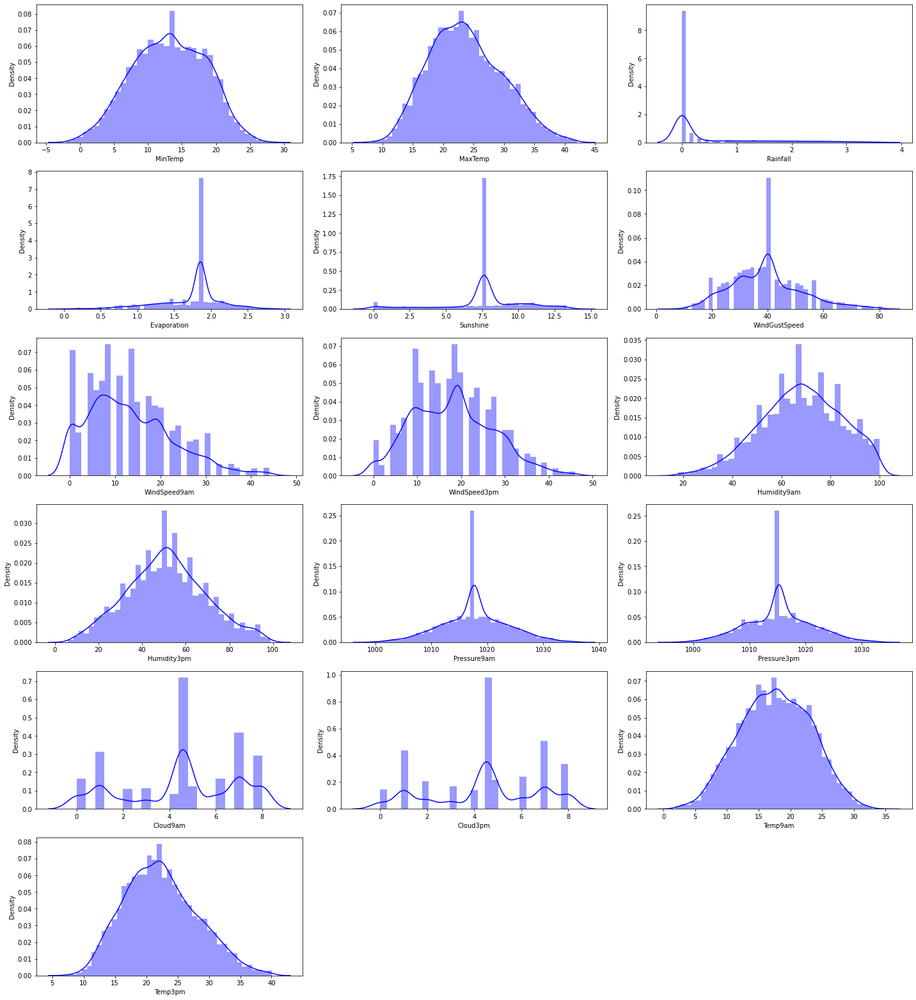

In [98]:
plt.figure(figsize=(20,25),facecolor='white')
plotnumber=1
for column in new_df_num_col:
    if plotnumber<=20:
        ax=plt.subplot(7,3,plotnumber)
        sns.distplot(new_df[column],color="b")
        plt.xlabel(column,fontsize=10)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()

# Encoding the categorical columns

In [99]:
le=LabelEncoder()
new_df[categorical_data]= new_df[categorical_data].apply(le.fit_transform)
new_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,0,1,13.4,22.900000,0.470004,1.85464,7.632205,13,44.000000,13,...,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0,0
1,1,1,7.4,25.100000,0.000000,1.85464,7.632205,14,44.000000,6,...,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0,0
2,2,1,12.9,25.700000,0.000000,1.85464,7.632205,15,46.000000,13,...,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0,0
3,3,1,9.2,28.000000,0.000000,1.85464,7.632205,4,24.000000,9,...,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0,0
4,4,1,17.5,32.300000,0.693147,1.85464,7.632205,13,41.000000,1,...,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2931,9,2.8,23.400000,0.000000,1.85464,7.632205,0,31.000000,9,...,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0,0
8421,2932,9,3.6,25.300000,0.000000,1.85464,7.632205,6,22.000000,9,...,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0,0
8422,2933,9,5.4,26.900000,0.000000,1.85464,7.632205,3,37.000000,9,...,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0,0
8423,2934,9,7.8,27.000000,0.000000,1.85464,7.632205,9,28.000000,10,...,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0,0


- Now we have converted the categorical columns into numerical columns using label encoding method.

<AxesSubplot:>

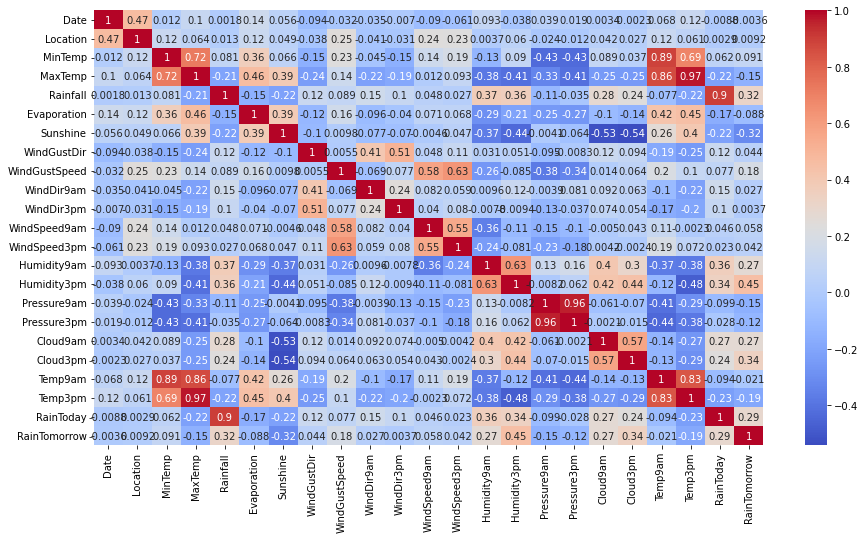

In [100]:
plt.figure(figsize=(15,8))
corr = new_df.corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')

# Prediction for Rain-Tomorrow

- Splitting feature and label into x and y

In [105]:
x = new_df.drop("RainTomorrow", axis=1)
y = new_df["RainTomorrow"]

Here we have seperated the feature and the label.

In [106]:
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,-1.530550,-1.508427,0.056444,-0.145732,-0.001029,0.2832,-0.013374,1.229267,0.364103,1.250245,...,0.638072,0.184123,-1.624174,-1.687142,-1.398115,1.425345,0.013138,-0.138099,-0.098593,-0.542476
1,-1.529355,-1.508427,-1.058476,0.220676,-0.543392,0.2832,-0.013374,1.441960,0.364103,-0.277857,...,0.421555,-1.455097,-1.457752,-1.202435,-1.279988,0.011773,0.013138,-0.084254,0.329747,-0.542476
2,-1.528159,-1.508427,-0.036466,0.320605,-0.543392,0.2832,-0.013374,1.654654,0.520531,1.250245,...,0.854590,-1.819368,-1.180382,-1.703856,-1.128109,0.011773,-1.076661,0.597788,0.141277,-0.542476
3,-1.526963,-1.508427,-0.724000,0.703668,-0.543392,0.2832,-0.013374,-0.684977,-1.200173,0.377044,...,-0.985811,-1.394385,-1.957019,-0.032451,-0.436219,0.011773,0.013138,0.077282,0.706687,-0.542476
4,-1.525768,-1.508427,0.818306,1.419829,0.256468,0.2832,-0.013374,1.229267,0.129462,-1.369358,...,0.205037,0.851954,-1.013959,-1.169007,-1.583744,1.013630,1.535531,0.023437,1.254963,-0.542476
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7982,1.974004,1.029423,-1.913248,-0.062457,-0.543392,0.2832,-0.013374,-1.535751,-0.652677,0.377044,...,-0.769293,-1.030114,-1.513226,1.137532,0.829435,0.011773,0.013138,-1.358595,0.004208,-0.542476
7983,1.975200,1.029423,-1.764592,0.253986,-0.543392,0.2832,-0.013374,-0.259589,-1.356601,0.377044,...,-0.985811,-0.726555,-1.679648,0.953678,0.626930,0.011773,0.013138,-1.215007,0.364014,-0.542476
7984,1.976395,1.029423,-1.430116,0.520464,-0.543392,0.2832,-0.013374,-0.897670,-0.183394,0.377044,...,-0.985811,-0.908690,-1.513226,0.535827,0.238796,0.011773,0.013138,-0.927832,0.638152,-0.542476
7985,1.977591,1.029423,-0.984148,0.537119,-0.543392,0.2832,-0.013374,0.378492,-0.887318,0.595344,...,-1.202329,-1.030114,-1.513226,0.268402,0.188170,-0.633229,-1.076661,-0.461172,0.621019,-0.542476


- The dataset has been now scaled to avoid any kind of bias in the modelling.

# Checking Multicollinearity

In [107]:
# Finding varience inflation factor in each scaled column
def calc_vif(x):
    vif = pd.DataFrame()
    vif["Features"] = x.columns
    vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    return(vif)

In [108]:
calc_vif(x)

,Features,VIF values
0,Date,1.482444
1,Location,1.537829
2,MinTemp,8.540725
3,MaxTemp,26.355028
4,Rainfall,5.628057
5,Evaporation,1.531349
6,Sunshine,1.983316
7,WindGustDir,1.614687
8,WindGustSpeed,2.315310
9,WindDir9am,1.348180


## Observation.
- We can see that we have high multicolinearity in features: MaxTemp, Pressure9am, Pressure3pm, Temp9am, Temp3pm.

In [109]:
# Dropping Temp3pm column
x.drop("Temp3pm",axis=1,inplace=True)

In [110]:
calc_vif(x)

,Features,VIF values
0,Date,1.482435
1,Location,1.536021
2,MinTemp,8.479346
3,MaxTemp,9.573733
4,Rainfall,5.625362
5,Evaporation,1.529711
6,Sunshine,1.983115
7,WindGustDir,1.611690
8,WindGustSpeed,2.301175
9,WindDir9am,1.347112


In [111]:
# Dropping Pressure9am column
x.drop("Pressure9am",axis=1,inplace=True)

In [112]:
calc_vif(x)

,Features,VIF values
0,Date,1.480898
1,Location,1.536021
2,MinTemp,8.351892
3,MaxTemp,9.189324
4,Rainfall,5.614242
5,Evaporation,1.513259
6,Sunshine,1.977968
7,WindGustDir,1.597388
8,WindGustSpeed,2.284195
9,WindDir9am,1.327279


In [113]:
# Dropping Temp9am column
x.drop("Temp9am",axis=1,inplace=True)

In [114]:
calc_vif(x)

,Features,VIF values
0,Date,1.454032
1,Location,1.534559
2,MinTemp,4.369960
3,MaxTemp,5.489234
4,Rainfall,5.602152
5,Evaporation,1.508926
6,Sunshine,1.969921
7,WindGustDir,1.595802
8,WindGustSpeed,2.249837
9,WindDir9am,1.327269



- Since "Temp3pm", "Pressure9am" and "Temp9am" have negative correlations with "RainTomorrow" and at the same time high VIF value hence we have dropped those 3 columns.

- Now we can see that we have corrected the multi-collinearity issue. We will proceed with SMOTE next.

# SMOTE

In [115]:
y.value_counts()

0    6165
1    1822
Name: RainTomorrow, dtype: int64

In [116]:
from imblearn.over_sampling import SMOTE
SM = SMOTE()
x, y = SM.fit_resample(x,y)

In [117]:
y.value_counts()

0    6165
1    6165
Name: RainTomorrow, dtype: int64

# Machine Learning

In [118]:
## Finding best random state

In [119]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.model_selection import train_test_split
rf = RandomForestClassifier()

In [120]:
maxAccu=0
maxRS=0

for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    rf.fit(x_train, y_train)
    pred = rf.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.9407948094079481  on Random_state  117


In [121]:
maxAccu=0
maxRS=0

for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.20, random_state =i)
    rf.fit(x_train, y_train)
    pred = rf.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.9480940794809408  on Random_state  140


In [122]:
# Importing required libraries
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

In [123]:
# creating a function to run all the classifiers

def classifier(model, x, y):
    x_train,x_test,y_train,y_test = train_test_split(x, y, test_size=0.2, random_state=174)
    
    # Training the model
    model.fit(x_train, y_train)
    
    # Predicting y_test
    pred = model.predict(x_test)
    
    # Accuracy Score
    acc_score = (accuracy_score(y_test, pred))*100
    print("Accuracy Score:", acc_score)
    
    # Classification Report
    class_report = classification_report(y_test, pred)
    print("\nClassification Report:\n", class_report)
    
    # Confusion Matrix
    Confusion_Matrix = confusion_matrix(y_test, pred)
    print("Confusion Matrix:\n", Confusion_Matrix)
    
    # Cross Validation Score
    cv_score = (cross_val_score(model, x, y, cv=5).mean())*100
    print("\nCross Validation Score:", cv_score)
    
    # Result of accuracy minus cv scores
    result = acc_score - cv_score
    print("\nAccuracy Score - Cross Validation Score is", result)

# Logistic Regression

In [124]:
model = LogisticRegression()
classifier(model, x, y)

Accuracy Score: 78.1021897810219

Classification Report:
               precision    recall  f1-score   support

           0       0.78      0.79      0.79      1272
           1       0.78      0.77      0.77      1194

    accuracy                           0.78      2466
   macro avg       0.78      0.78      0.78      2466
weighted avg       0.78      0.78      0.78      2466

Confusion Matrix:
 [[1009  263]
 [ 277  917]]

Cross Validation Score: 72.05190592051906

Accuracy Score - Cross Validation Score is 6.050283860502844


# Naive Bayes

In [125]:
model = GaussianNB()
classifier(model, x, y)

Accuracy Score: 73.80373073803732

Classification Report:
               precision    recall  f1-score   support

           0       0.74      0.76      0.75      1272
           1       0.73      0.72      0.73      1194

    accuracy                           0.74      2466
   macro avg       0.74      0.74      0.74      2466
weighted avg       0.74      0.74      0.74      2466

Confusion Matrix:
 [[962 310]
 [336 858]]

Cross Validation Score: 70.94890510948906

Accuracy Score - Cross Validation Score is 2.854825628548255


# SVC Classifier

In [126]:
model = SVC(kernel='rbf')
classifier(model, x, y)

Accuracy Score: 85.52311435523114

Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.83      0.86      1272
           1       0.83      0.88      0.85      1194

    accuracy                           0.86      2466
   macro avg       0.86      0.86      0.86      2466
weighted avg       0.86      0.86      0.86      2466

Confusion Matrix:
 [[1061  211]
 [ 146 1048]]

Cross Validation Score: 73.10624493106246

Accuracy Score - Cross Validation Score is 12.41686942416868


In [127]:
model = SVC(kernel='poly')
classifier(model, x, y)

Accuracy Score: 83.29278183292782

Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.86      0.84      1272
           1       0.85      0.80      0.82      1194

    accuracy                           0.83      2466
   macro avg       0.83      0.83      0.83      2466
weighted avg       0.83      0.83      0.83      2466

Confusion Matrix:
 [[1097  175]
 [ 237  957]]

Cross Validation Score: 73.67396593673966

Accuracy Score - Cross Validation Score is 9.618815896188153


# Decision Tree Classifier

In [128]:
model = DecisionTreeClassifier()
classifier(model, x, y)

Accuracy Score: 87.87510137875101

Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.87      0.88      1272
           1       0.86      0.89      0.88      1194

    accuracy                           0.88      2466
   macro avg       0.88      0.88      0.88      2466
weighted avg       0.88      0.88      0.88      2466

Confusion Matrix:
 [[1104  168]
 [ 131 1063]]

Cross Validation Score: 73.60097323600974

Accuracy Score - Cross Validation Score is 14.274128142741276


# KNeighbors Classifier

In [129]:
model = KNeighborsClassifier()
classifier(model, x, y)

Accuracy Score: 86.65855636658556

Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.78      0.86      1272
           1       0.80      0.96      0.87      1194

    accuracy                           0.87      2466
   macro avg       0.88      0.87      0.87      2466
weighted avg       0.88      0.87      0.87      2466

Confusion Matrix:
 [[ 992  280]
 [  49 1145]]

Cross Validation Score: 72.45742092457421

Accuracy Score - Cross Validation Score is 14.20113544201135


# SGD Classifier

In [130]:
model = SGDClassifier()
classifier(model, x, y)

Accuracy Score: 77.45336577453365

Classification Report:
               precision    recall  f1-score   support

           0       0.78      0.78      0.78      1272
           1       0.77      0.77      0.77      1194

    accuracy                           0.77      2466
   macro avg       0.77      0.77      0.77      2466
weighted avg       0.77      0.77      0.77      2466

Confusion Matrix:
 [[996 276]
 [280 914]]

Cross Validation Score: 72.30332522303324

Accuracy Score - Cross Validation Score is 5.15004055150041


# Random Forest Classifier

In [131]:
model = RandomForestClassifier()
classifier(model, x, y)

Accuracy Score: 93.91727493917274

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.94      0.94      1272
           1       0.94      0.94      0.94      1194

    accuracy                           0.94      2466
   macro avg       0.94      0.94      0.94      2466
weighted avg       0.94      0.94      0.94      2466

Confusion Matrix:
 [[1197   75]
 [  75 1119]]

Cross Validation Score: 78.1265206812652

Accuracy Score - Cross Validation Score is 15.790754257907537


In [132]:
model = RandomForestClassifier(random_state=174)
classifier(model, x, y)

Accuracy Score: 94.0389294403893

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.94      0.94      1272
           1       0.94      0.94      0.94      1194

    accuracy                           0.94      2466
   macro avg       0.94      0.94      0.94      2466
weighted avg       0.94      0.94      0.94      2466

Confusion Matrix:
 [[1196   76]
 [  71 1123]]

Cross Validation Score: 78.29683698296837

Accuracy Score - Cross Validation Score is 15.742092457420924


# ExtraTrees Classifier

In [133]:
model = ExtraTreesClassifier()
classifier(model, x, y)

Accuracy Score: 95.57988645579887

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.94      0.96      1272
           1       0.94      0.97      0.96      1194

    accuracy                           0.96      2466
   macro avg       0.96      0.96      0.96      2466
weighted avg       0.96      0.96      0.96      2466

Confusion Matrix:
 [[1199   73]
 [  36 1158]]

Cross Validation Score: 78.85644768856447

Accuracy Score - Cross Validation Score is 16.7234387672344


In [134]:
model = ExtraTreesClassifier(random_state=174)
classifier(model, x, y)

Accuracy Score: 95.21492295214922

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.94      0.95      1272
           1       0.94      0.96      0.95      1194

    accuracy                           0.95      2466
   macro avg       0.95      0.95      0.95      2466
weighted avg       0.95      0.95      0.95      2466

Confusion Matrix:
 [[1197   75]
 [  43 1151]]

Cross Validation Score: 78.82400648824006

Accuracy Score - Cross Validation Score is 16.390916463909164


# AdaBoost Classifier

In [135]:
model = AdaBoostClassifier()
classifier(model, x, y)

Accuracy Score: 81.50851581508516

Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.82      0.82      1272
           1       0.81      0.81      0.81      1194

    accuracy                           0.82      2466
   macro avg       0.81      0.81      0.81      2466
weighted avg       0.82      0.82      0.82      2466

Confusion Matrix:
 [[1042  230]
 [ 226  968]]

Cross Validation Score: 66.04217356042173

Accuracy Score - Cross Validation Score is 15.46634225466343


# Gradient Boosting Classifier

In [136]:
model = GradientBoostingClassifier()
classifier(model, x, y)

Accuracy Score: 85.48256285482563

Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.86      0.86      1272
           1       0.85      0.85      0.85      1194

    accuracy                           0.85      2466
   macro avg       0.85      0.85      0.85      2466
weighted avg       0.85      0.85      0.85      2466

Confusion Matrix:
 [[1094  178]
 [ 180 1014]]

Cross Validation Score: 67.77777777777779

Accuracy Score - Cross Validation Score is 17.704785077047845


# Observation:
- Comparing all the above the ExtraTreesClassifier gives the best results since the Accuracy Score - Cross Validation Score is the least along with higher Cross Validation Score and the highest Accuracy Score comparing all the models.

# Hyper Parameter Tuning

In [137]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.20,random_state=174)

In [138]:
x_test.shape

(2466, 19)

In [139]:
y_test.shape

(2466,)

In [140]:

x_train.shape

(9864, 19)

In [141]:
y_train.shape

(9864,)

In [142]:
parameters = {'criterion' : ['gini', 'entropy'],
              'max_features' : ['auto', 'sqrt', 'log2'],
              'n_jobs' : [-2, -1, 1],
              'random_state' : [None, 174],
              'n_estimators': [100, 200, 300]}

In [143]:
GCV = GridSearchCV(ExtraTreesClassifier(), parameters, cv=5)

In [144]:
GCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [100, 200, 300], 'n_jobs': [-2, -1, 1],
                         'random_state': [None, 174]})

In [145]:
GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [100, 200, 300], 'n_jobs': [-2, -1, 1],
                         'random_state': [None, 174]})

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [100, 200, 300], 'n_jobs': [-2, -1, 1],
                         'random_state': [None, 174]})

In [146]:
GCV.best_params_      # printing best parameters found by GridSearchCV

{'criterion': 'gini',
 'max_features': 'auto',
 'n_estimators': 300,
 'n_jobs': 1,
 'random_state': None}

In [147]:
final_modelc = ExtraTreesClassifier(criterion = 'entropy', max_features = 'auto', n_estimators = 300, n_jobs = -1 , random_state = None) 

In [148]:
final_fitc = final_modelc.fit(x_train,y_train)   # final fit
final_predc = final_modelc.predict(x_test)   # predicting with best parameters

In [149]:
best_acc_score = (accuracy_score(y_test, final_predc))*100    # checking accuracy score
print("The Accuracy Score for the Best Model is ", best_acc_score)

The Accuracy Score for the Best Model is  95.25547445255475


#### We successfully performed the Hyper Parameter Tuning on the Final Model.

# Final Cross Validation Score

In [150]:
# Final Cross Validation Score
final_cv_score = (cross_val_score(final_modelc, x, y, cv=5).mean())*100
print("Cross Validation Score:", final_cv_score)

Cross Validation Score: 79.53771289537713


In [151]:
# Final Classification Report
final_class_report = classification_report(y_test, final_predc)
print("\nClassification Report:\n", final_class_report)


Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.94      0.95      1272
           1       0.94      0.96      0.95      1194

    accuracy                           0.95      2466
   macro avg       0.95      0.95      0.95      2466
weighted avg       0.95      0.95      0.95      2466



# Confusion Matrix

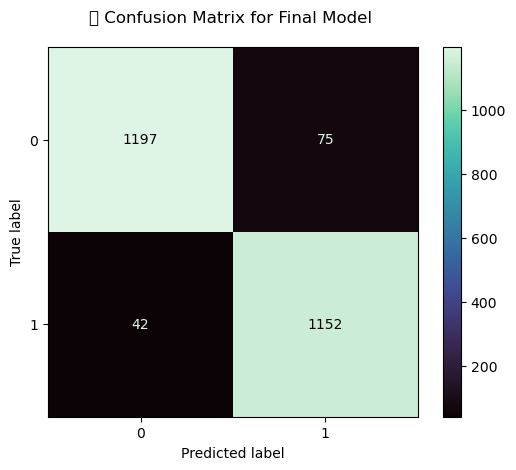

In [152]:
plt.style.use('default')
class_names = df.columns
metrics.plot_confusion_matrix(final_modelc, x_test, y_test, cmap='mako')
plt.title('\t Confusion Matrix for Final Model \n')
plt.show()

With the help of above confusion matrix I am able to understand the number of times I got the correct outputs and the number of times my ML model missed to provide the correct prediction (depicting in the black boxes).

# AUC ROC curve

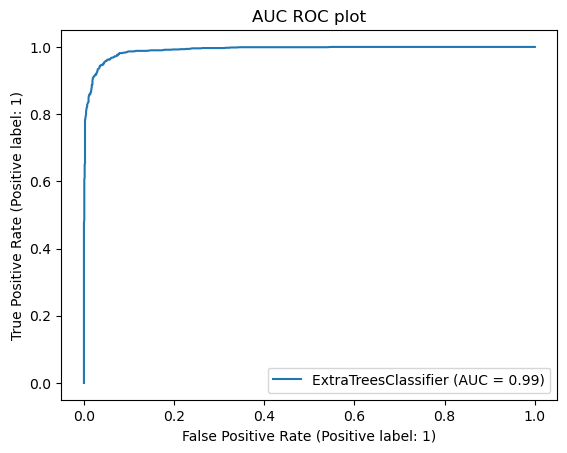

In [153]:
from sklearn.metrics import plot_roc_curve
plot_roc_curve(final_modelc, x_test, y_test)
plt.title("AUC ROC plot")
plt.show()


We got final accuracy score of 95.377% and Cross Validation Score of 80.3568% and also AUC score is 0.99 which is really good.

# Saving the model in pickle Format

In [154]:
# pickeling or serialization of a file
import pickle
filename = 'Rainfall_Prediction_Weather_Forecasting_Rain_Tomorrow_Final_Model.pkl'
pickle.dump(final_modelc, open(filename, 'wb'))

# Prediction Conclusion:

In [155]:
import numpy as np
ac=np.array(y_test)
predictedc=np.array(final_modelc.predict(x_test))
df_comparisonc = pd.DataFrame({"original":ac,"predicted":predictedc},index= range(len(ac)))
df_comparisonc

,original,predicted
0,0,0
1,0,1
2,1,1
3,1,1
4,0,0
...,...,...
2461,1,1
2462,1,1
2463,0,0
2464,1,1


In [156]:
df_comparisonc.to_csv('IRainfall_Prediction_Weather_Forecasting_Rain_Tomorrow_Prediction.csv')